# Continuity-preserving simplification of rectangular artifacts

This notebook contains experiments simplifying rectangular artifacts while preserving continuity of the network.

In [1]:
import folium
import geopandas as gpd
import matplotlib.pyplot as plt
import momepy
import numpy as np
import pandas as pd
import shapely
from core import utils, algorithms, geometry
from folium import plugins
from itertools import combinations

from libpysal import graph
from scipy import sparse, spatial
from tqdm import tqdm

Specify case metadata

In [2]:
case = "Liège"

Read road data

In [3]:
roads = utils.read_parquet_roads(case)

Remove false nodes (nodes with degree 2)

In [4]:
%%time
# roads = momepy.remove_false_nodes(roads)
roads = gpd.read_parquet("temp.pq")

CPU times: user 115 ms, sys: 10.1 ms, total: 125 ms
Wall time: 156 ms


Read artifacts

Assign COINS-based information to roads

In [25]:
roads.geometry.duplicated().sum()

18

In [28]:
roads_clean = roads[~roads.geometry.duplicated()].reset_index()

In [29]:
%%time
roads = algorithms.common.continuity(roads_clean)

CPU times: user 10.9 s, sys: 285 ms, total: 11.2 s
Wall time: 12.3 s


In [6]:
artifacts = gpd.read_parquet(
    f"../data/{utils.city_fua[case]}/polygons",
    columns=["geometry", "is_artifact", "circular_compactness"],
)
artifacts = artifacts[artifacts.is_artifact].reset_index(drop=True)
artifacts["id"] = artifacts.index

In [32]:
artifacts.explore(prefer_canvas=True)

Get nodes from the network.

In [7]:
first = shapely.get_point(roads.geometry, 0)
last = shapely.get_point(roads.geometry, -1)
possible_nodes = gpd.GeoSeries(
    pd.concat([first, last], ignore_index=True), crs=roads.crs
)
nodes = possible_nodes[~possible_nodes.duplicated()]

Link nodes to artifacts

In [8]:
node_idx, artifact_idx = artifacts.sindex.query(
    nodes.buffer(0.1), predicate="intersects"
)
intersects = sparse.coo_array(
    ([True] * len(node_idx), (node_idx, artifact_idx)),
    shape=(len(nodes), len(artifacts)),
    dtype=np.bool_,
)

Filter out rectangles, i.e. artifacts with four entry points.

In [9]:
rectangles = artifacts[intersects.sum(axis=0) == 4]

Apply additional filters to remove artifacts that are not suitable for simplification. These may be artifacts that:
- are too large in size
- have a shape that is too non-rectanglish (*I am sure this is not a word but I like it anyway*)
- are part of a larger intersection that may need different methods of simplification

In [10]:
area_threshold = 1250  # this is hard to determine but it can be done iteratively using different thresholds
circular_compactness_threshold = 0.15  # same as above

rook = graph.Graph.build_contiguity(artifacts, rook=True)

# keep only those artifacts which occur as isolates, i.e. are not part of a larger intersection
rectangles = rectangles.loc[rectangles.index.intersection(rook.isolates)]
rectangles = rectangles.loc[
    (rectangles.area < area_threshold)
    & (rectangles.circular_compactness > circular_compactness_threshold)
]

In [11]:
m = roads.explore(
    "coins_len",
    k=20,
    scheme="quantiles",
    tiles="cartodb positron",
    prefer_canvas=True,
    name="Roads",
    highlight_kwds={"color": "red"},
    max_zoom=52,
)
rectangles.explore(m=m, name="Artifacts")
nodes.explore(m=m, name="Nodes", color="red")
folium.LayerControl().add_to(m)
plugins.MousePosition().add_to(m)

m

- roundabout
    - 50.6239 5.60087
    - snap to centroid
- parallels
    - two incoming, one before and after
        - 50.62848 5.59877
        - 50.62929 5.64827
        - replace with a centerline
    - two before and after
        - 50.63506 5.57835
        - replace with a centerline
- rectangle
    - two before and after, one ending, one isolated
        - 50.62784 5.58373
            - keep the two, snap the entry point across to the node
        - 50.59088 5.53892
            - remove the shortcut?
- triangle with additional entry point
    - 50.62095 5.62205
        - ?
    - 50.64175 5.64026
        - ? (what if there's more than one additional?)
    - 50.66548 5.63043
    - 50.71791 5.68404
    - 50.62879 5.54425
- trapezoid
    50.6834 5.64015
- possible remapping of continuity?
    - 50.66448 5.57893

## Case 1

If all four edges are part of the same continuiry block (roundabout):
- drop all of them and link the entry points to the centroid of the artifact

<Axes: >

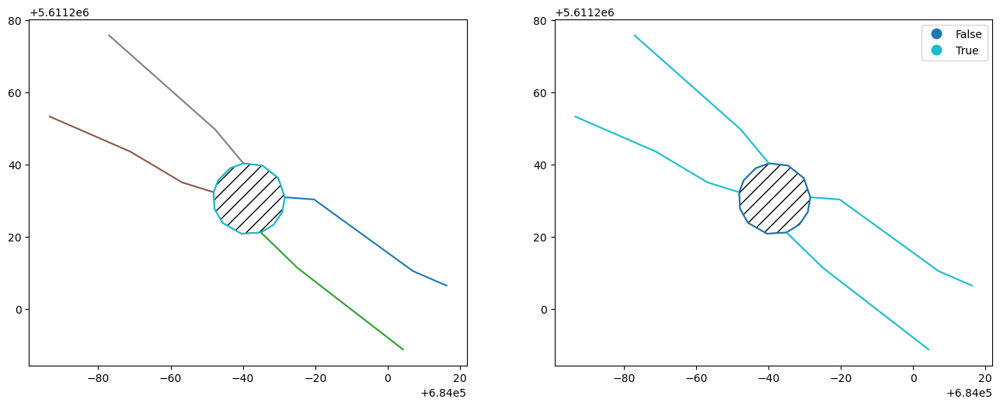

In [12]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.60087, 50.6239)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [13]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 0  # no ends
assert (edges.coins_count == 1).sum() == 0  # no continuity block is a single edge
assert edges.coins_group.nunique() == 1  # all edges belong to the same continuity block

Mark all for removal and replace them with shortest lines to the centroid.

In [14]:
centroid = geom.centroid.item()
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]


to_drop = []
to_add = []

to_drop.extend(edges.index.to_list())
to_add.extend(shapely.shortest_line(relevant_nodes, centroid).to_list())

Generate new road data

In [15]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

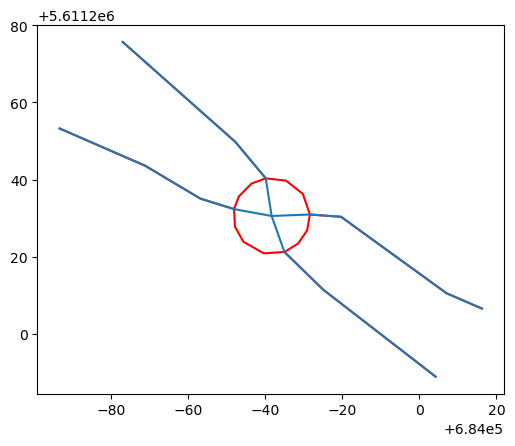

In [16]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 2

Two edges are part of an incoming continuity group that ends there, one edge is part of a group that continues before and after.
- replace the incoming with the centerline

<Axes: >

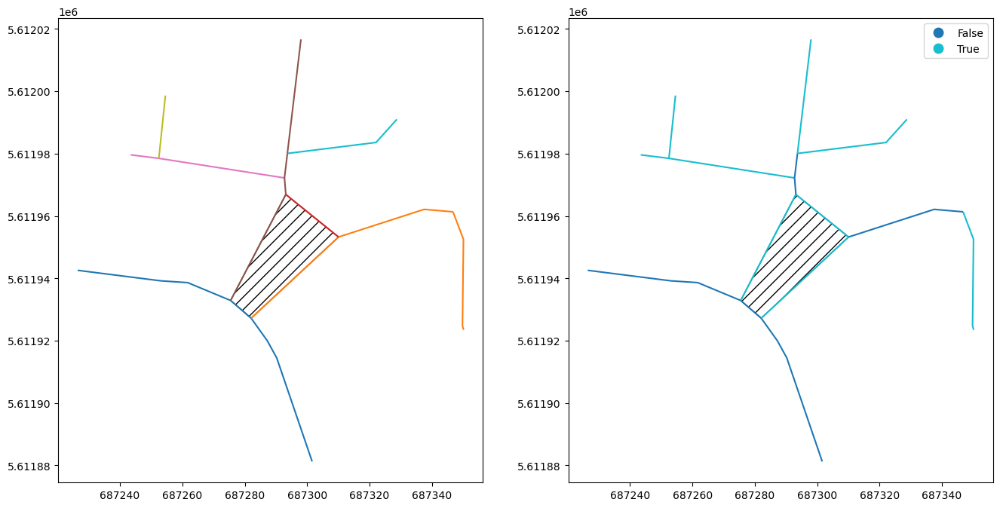

In [17]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64827, 50.62929)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [18]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 3  # 3 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block is a single edge

Get edges that shall be removed in favour of the skeleton.

In [19]:
edges_to_merge = edges[edges.coins_end]
snapping_targets = edges[~edges.coins_end]

Generate the skeleton.

In [20]:
skeleleton = geometry.voronoi_skeleton(
    edges_to_merge.geometry, geom.item(), snap_to=snapping_targets.geometry
)

/Users/martin/miniforge3/envs/simplification/lib/python3.11/site-packages/shapely/set_operations.py:131: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


Mark the unnecessary edges for removal and new ones for addition.

In [21]:
to_drop = []
to_add = []

to_drop += edges_to_merge.index.tolist()
to_add.extend(skeleleton)

Generate new road data

In [22]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

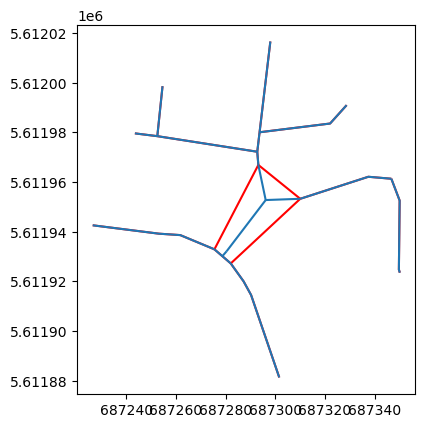

In [23]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

TODO: ensure the line gets split

## Case 3

two before and after
        

<Axes: >

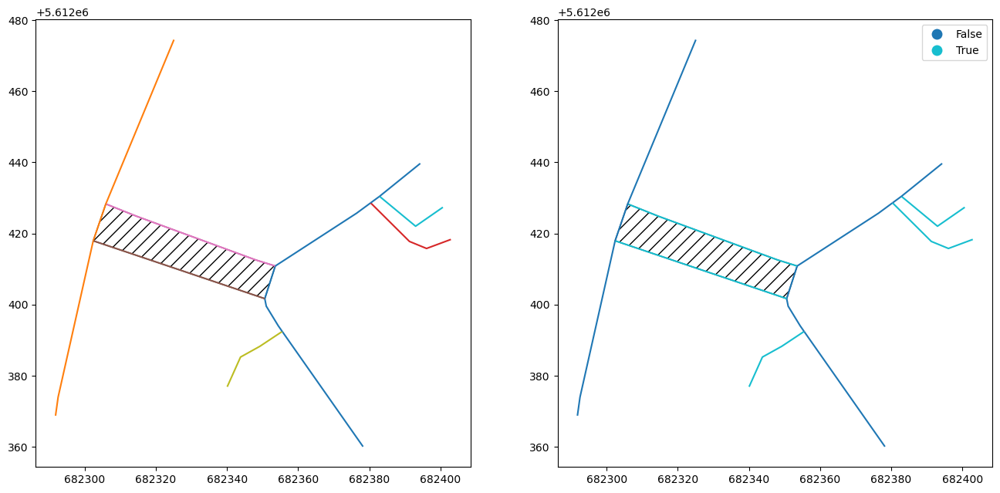

In [24]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.57835, 50.63506)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [25]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 2 ends
assert (edges.coins_count == 1).sum() == 2  # 2 continuity block as a single edge

Get edges that shall be removed in favour of the skeleton.

In [26]:
edges_to_merge = edges[edges.coins_end]
snapping_targets = edges[~edges.coins_end]

Generate the skeleton.

In [27]:
skeleleton = geometry.voronoi_skeleton(
    edges_to_merge.geometry, geom.item(), snap_to=snapping_targets.geometry
)

Mark the unnecessary edges for removal and new ones for addition.

In [28]:
to_drop = []
to_add = []

to_drop += edges_to_merge.index.tolist()
to_add.extend(skeleleton)

Generate new road data

In [29]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

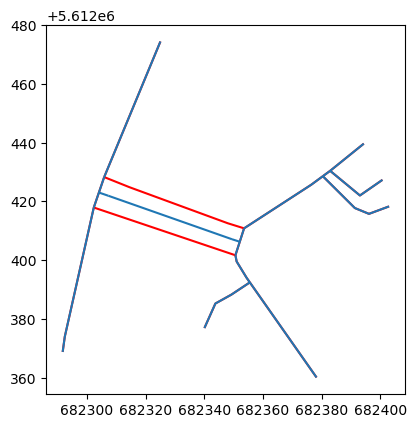

In [30]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 4

rectangle
    - two before and after, one ending, one isolated        

<Axes: >

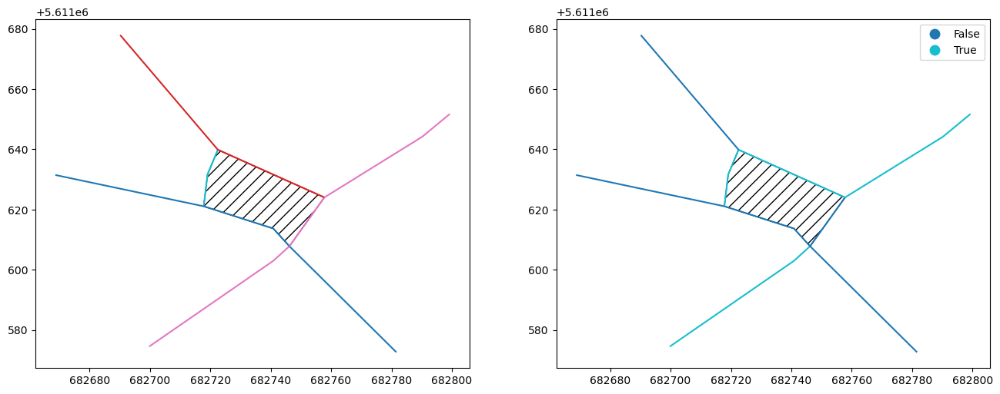

In [31]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.58373, 50.62784)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [32]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 2 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert (
    mains.intersects(mains[::-1], align=False).all()
)  # two main roads intersect
assert mains.coins_group.nunique() == 2

Extract nodes, identify the main road and an entry node on the other side. Generate the shortest line.

In [33]:
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]
main_roads = edges.geometry[~edges.coins_end]
entry_node = relevant_nodes[relevant_nodes.disjoint(main_roads.unary_union)].item()
target_node = relevant_nodes.iloc[
    np.argmax(np.bincount(relevant_nodes.sindex.query(main_roads)[1]))
]
new_line = shapely.LineString([entry_node, target_node])

Mark the unnecessary edge for removal.

In [34]:
to_drop = []
to_add = []

to_drop.extend(edges[edges.coins_end].index.tolist())
to_add.append(new_line)

Generate new road data

In [35]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

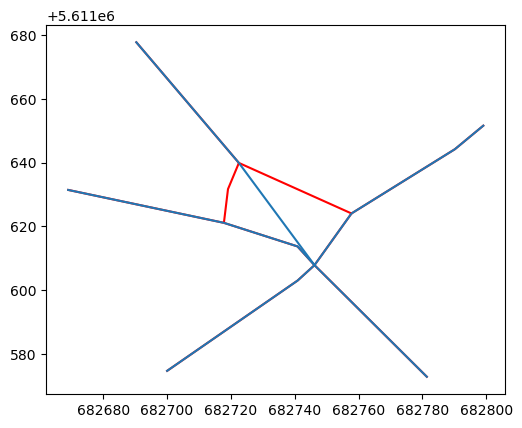

In [36]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 4b

two before and after
        

<Axes: >

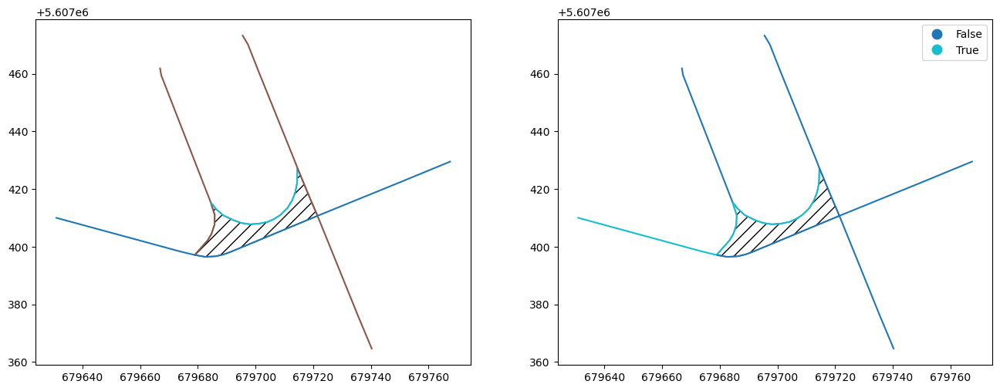

In [37]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.53892, 50.59088)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [38]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 2 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert (
    mains.intersects(mains[::-1], align=False).all()
)  # two main roads intersect
assert mains.coins_group.nunique() == 2

Extract nodes, identify the main road and an entry node on the other side. Generate the shortest line.

In [39]:
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]
main_roads = edges.geometry[~edges.coins_end]
entry_node = relevant_nodes[relevant_nodes.disjoint(main_roads.unary_union)].item()
target_node = relevant_nodes.iloc[
    np.argmax(np.bincount(relevant_nodes.sindex.query(main_roads)[1]))
]
new_line = shapely.LineString([entry_node, target_node])

Mark the unnecessary edge for removal.

In [40]:
to_drop = []
to_add = []

to_drop.extend(edges[edges.coins_end].index.tolist())
to_add.append(new_line)

Generate new road data

In [41]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

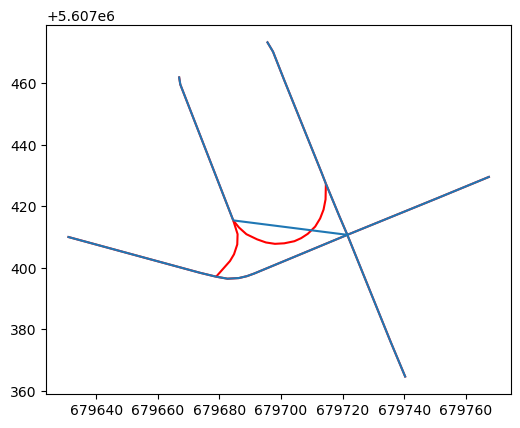

In [42]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 5

triangle with additional entry point leading to the main road
- Two ends, one crossing.
- Drop the non-crossing edge

<Axes: >

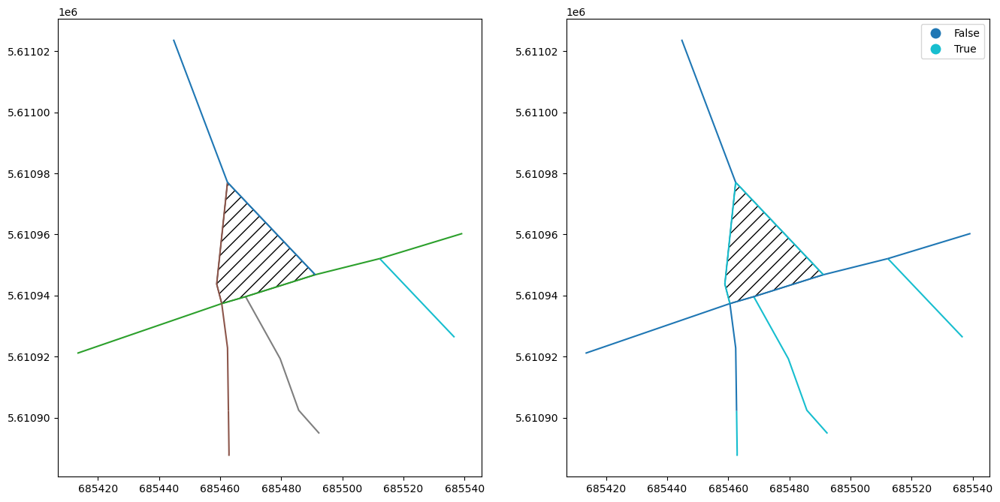

In [43]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.62205, 50.62095)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [44]:
edges_extended = roads.iloc[roads.sindex.query(geom.item(), predicate="intersects")]
edges = edges_extended.iloc[
    edges_extended.sindex.query(geom.item(), predicate="covers")
]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 1 ends
assert (edges.coins_count == 1).sum() == 0  # no continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert (
    mains.intersects(mains[::-1], align=False).all()
)  # two main roads intersect
assert mains.coins_group.nunique() == 1
assert len(mains) == 2

Identify main and non-main roads.

In [45]:
main_road = edges[~edges.coins_end]
main_group = main_road.coins_group.unique().item()
non_main = edges_extended[edges_extended.coins_group != main_group]

In [46]:
to_drop = []
to_add = []

intersections_per_group = (
    non_main.intersects(main_road.unary_union).groupby(non_main.coins_group).sum() > 1
)
to_drop.append(
    edges[
        edges.coins_group.isin(intersections_per_group.index[~intersections_per_group])
    ].index.item()
)

Generate new road data

In [47]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

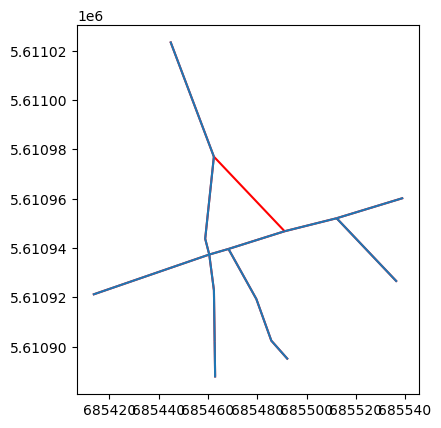

In [48]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 5b

triangle with additional entry point leading to the non-main road
- one ends, no crossing, one single
- Drop the single edge

<Axes: >

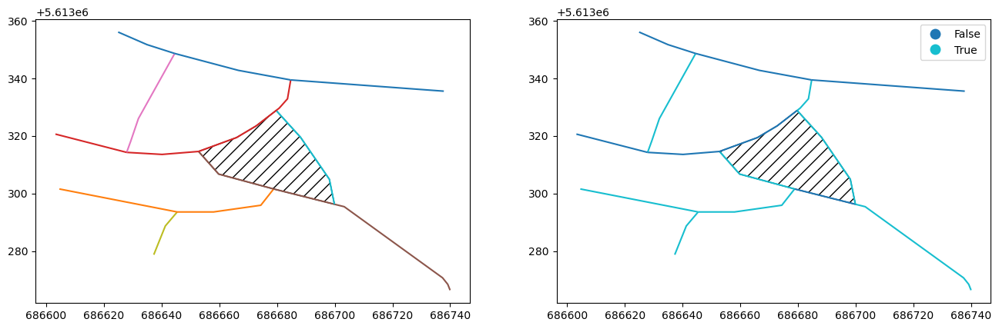

In [49]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64026, 50.64175)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [50]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 1 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert len(mains) == 1

Drop the edge that is its own continuity group

In [51]:
to_drop = []
to_add = []

to_drop.append((edges.coins_count == 1).idxmax())

Generate new road data

In [52]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

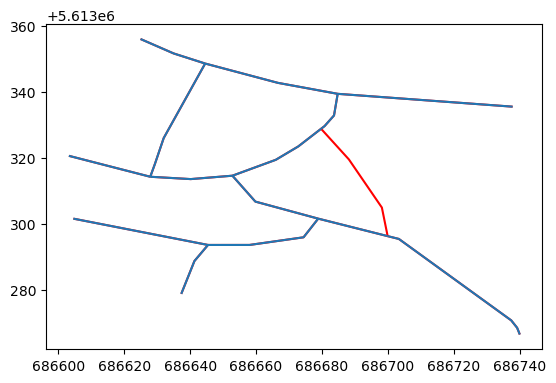

In [53]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 5c

<Axes: >

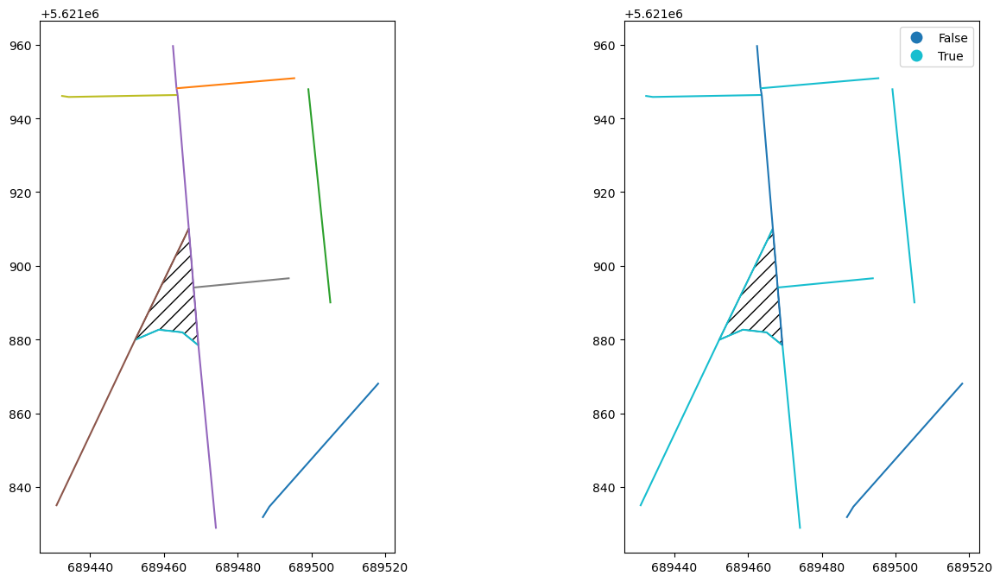

In [54]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.68404, 50.71791)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [55]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 1 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert (
    mains.intersects(mains[::-1], align=False).all()
)  # two main roads intersect
assert mains.coins_group.nunique() == 1
assert len(mains) == 2

Drop the edge that is its own continuity group

In [56]:
to_drop = []
to_add = []

to_drop.append((edges.coins_count == 1).idxmax())

Generate new road data

In [57]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

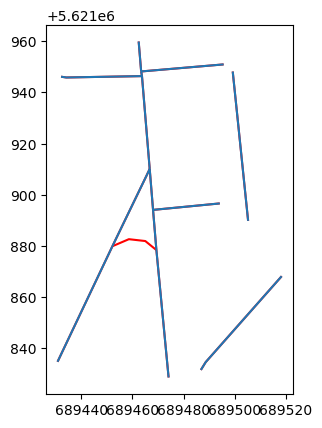

In [58]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Broken COINS

<Axes: >

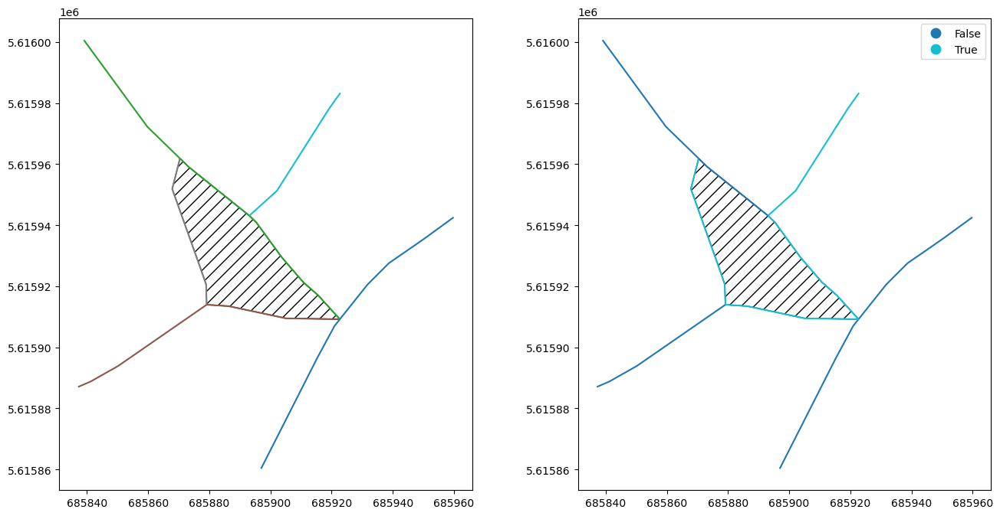

In [30]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.63043, 50.66548)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 6

trapezoid

- replace all by connections between nodes

<Axes: >

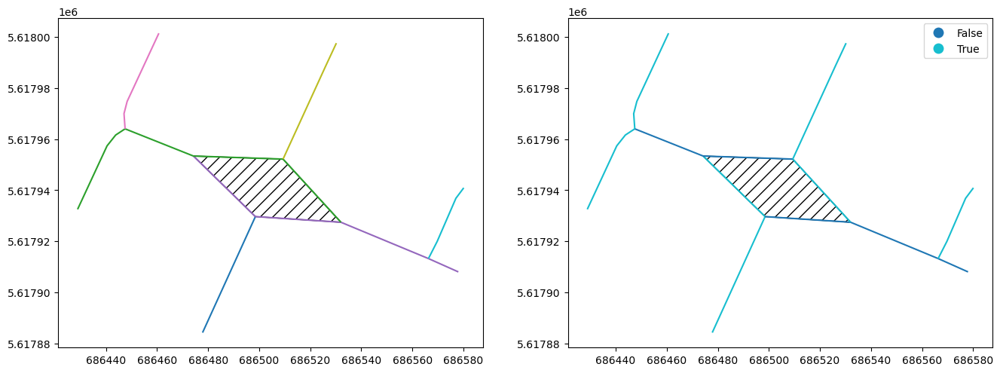

In [77]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64015, 50.6834)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [78]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 2 ends
assert (edges.coins_count == 1).sum() == 0  # 0 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert len(mains) == 0
assert edges.coins_group.nunique() == 2

Get nodes

In [79]:
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]

In [80]:
center = relevant_nodes.unary_union.centroid

Mark the unnecessary edges for removal and new ones for addition.

In [86]:
to_drop = []
to_add = []

to_drop.extend(edges.index.to_list())
to_add.extend(shapely.shortest_line(relevant_nodes, center).to_list())

Generate new road data

In [87]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

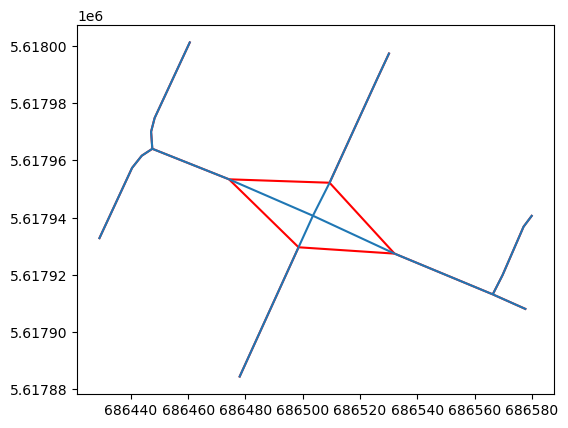

In [88]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Tricky case

This is topologically 5b

<Axes: >

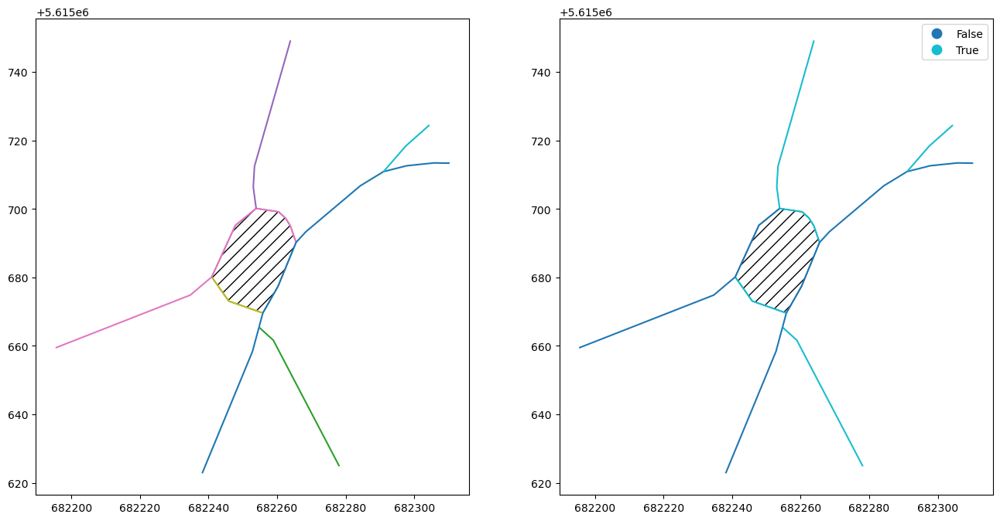

In [67]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.57893, 50.66448)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [68]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 2  # 1 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block as a single edge
ends = edges[edges.coins_end]
mains = edges[~edges.coins_end]
mask = []
for coin, edge in zip(mains.coins_group, mains.geometry, strict=True):
    if ends[ends.coins_group == coin].intersects(edge).any():
        mask.append(False)
    else:
        mask.append(True)
mains = mains[mask]
assert len(mains) == 1

Drop the edge that is its own continuity group

In [69]:
to_drop = []
to_add = []

to_drop.append((edges.coins_count == 1).idxmax())

Generate new road data

In [70]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

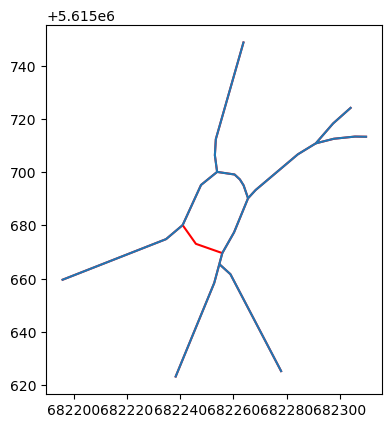

In [71]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

**However**, the manual simplification is trating it as case 6. This partially makes sense but completely re-maps continuity

Get nodes

In [72]:
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]

In [73]:
center = relevant_nodes.unary_union.centroid

Mark the unnecessary edges for removal and new ones for addition.

In [74]:
to_drop = []
to_add = []

to_drop += edges.index.tolist()

for node in relevant_nodes:
    to_add.append(shapely.LineString([node, center]))

Generate new road data

In [75]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

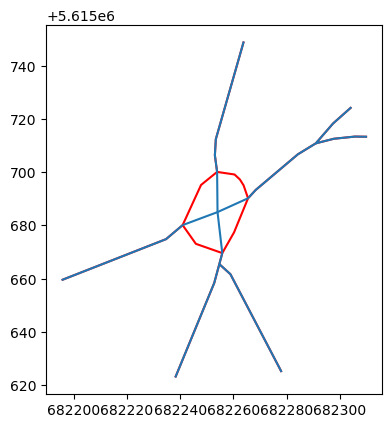

In [76]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

In [22]:
roads[roads.intersects(shapely.Point(682619.7584150723, 5612995.734446571).buffer(1))].explore()

In [21]:
roads[roads.coins_group == 572]

,geometry,coins_group,coins_len,coins_count,coins_end
729,"LINESTRING (682619.758 5612995.734, 682615.849...",572,26.603893,2,True
730,"LINESTRING (682619.758 5612995.734, 682615.849...",572,26.603893,2,True
